# Aim: Add a feature which allows plots to be passed to a pre-generated report

In [1]:
import sys
import os
from os.path import join, abspath
print(os.getcwd())
repo_dir = abspath(join(os.getcwd(),os.pardir, os.pardir))
if repo_dir not in sys.path:
    sys.path = [repo_dir] + sys.path
print(repo_dir)

/Users/jillianaugustine/OneDrive - Crayon Group/GitHub/dataprep/dataprep/custom
/Users/jillianaugustine/OneDrive - Crayon Group/GitHub/dataprep


In [28]:
# requirements from datapreps
from dataprep.datasets import load_dataset
from dataprep.eda.create_report import create_report
from dataprep.eda.configs import Config
from dataprep.eda.create_report.formatter import format_basic
from jinja2 import Environment, PackageLoader

# other python imports
import re
import glob
import pandas as pd
import numpy as np
import yaml
import json
import PIL.Image
from importlib import reload
from plotly.graph_objects import Figure as goFigure
import matplotlib.pyplot as plt
import seaborn as sns

# imports from custom module
import dataprep.custom.custom_reports as cr
import dataprep.custom.custom_objects as co

### TODOs
- edit html so objects in a section are shown one after each other instead or using tabs?
- Add a subtitle argument to each custom section?

In [ ]:
conf = 

In [3]:
df = load_dataset("titanic")

In [4]:
context = cr.create_custom_report(df, returncontext=True, returnreport=False)
# report, context = cr.create_custom_report(df, returncontext=True, returnreport=True)
# report.show_browser()

  0%|          | 0/1498 [00:00<?, ?it/s]

In [5]:
empty_context = cr.create_empty_context()
cr.create_custom_report(context=empty_context).show_browser()

In [13]:
for k, v in empty_context.items():
    if k != "resources":
        print(f"{k}:\n{v}")
        print("-"*5)

title:
None
-----
components:
{'overview_insights': None, 'overview': None, 'has_overview': None, 'variables': None, 'has_variables': None, 'has_interaction': None, 'interactions': None, 'has_correlation': None, 'correlation_names': None, 'correlations': None, 'has_missing': None, 'missing': None, 'missing_tabs': None}
-----


In [18]:
reload(co)
x = co.CustomMarkdown("My Markdown", "## hi")
x.html

'<h2>hi</h2>'

  0%|          | 0/419 [00:00<?, ?it/s]

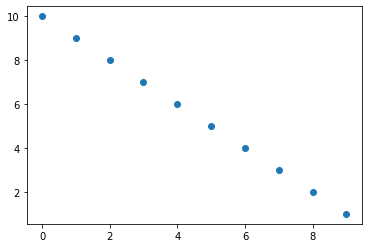

In [27]:
reload(co)
reload(cr)
from dataprep.eda import plot as dp_plot

fig, ax = plt.subplots()
# _ = sns.scatterplot(x = np.arange(0, 10, 1), y = np.arange(10, 0, -1), ax=ax)
ax.scatter(x = np.arange(0, 10, 1), y = np.arange(10, 0, -1))

# create section containing markdown
cs1 = co.CustomSection(
    title="My Section 1",
    customobjects=co.CustomMarkdown("My Markdown", "## hi")
)

# create section containing dataprep container
cs2 = co.CustomSection(
    title="My Section 2",
    customobjects=co.CustomDataPrep("My dataprep object", dp_plot(df)))

cs3 = co.CustomSection(
    title="My Section 3",
    customobjects=co.CustomMatplotlib("My MPL", fig)
)

# create empty context
context = cr.create_empty_context()

# add title to context
context = cr.add_title(context, "Title of my report")

# add section to context
context = cr.add_section(context, [cs1, cs2, cs3])

# create report
report = cr.create_custom_report(context=context)
report.show_browser()


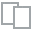
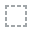
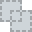
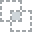
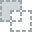
...
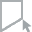
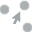
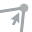
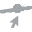
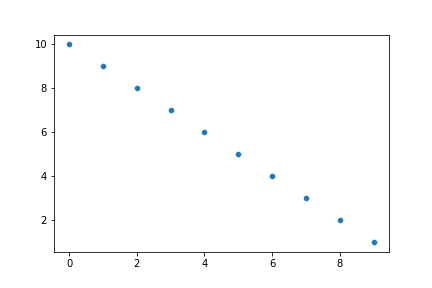

In [22]:
report.show()

<AxesSubplot:>

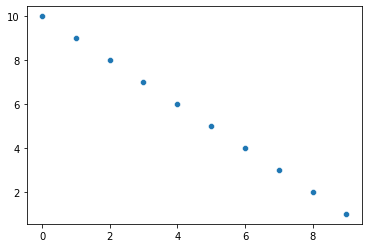

In [17]:
fig, ax = plt.subplots()
_ = sns.scatterplot(x = np.arange(0, 10, 1), y = np.arange(10, 0, -1), ax=ax)

with BytesIO() as buffer:
                obj.save(buffer, format="PNG")
                byte_data=buffer.getvalue()
            # might have to change this to urlib.parse.quote instead of .decode()
            # if .decode() doesn't work
            image_str=base64.b64encode(byte_data).decode(encoding="utf-8")
            self.image_str=image_str
            image_url=f"data:image/png;base64,{image_str}"
            self.image_url=image_url
            self.html=f'<img class="custom-image" src="{image_url}" />'

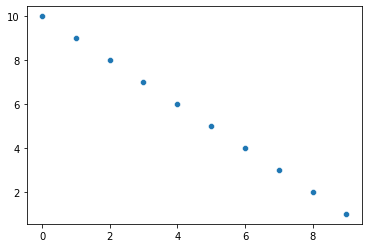

In [19]:
reload(cr)
reload(co)
fig

In [49]:
c2["components"]

{'overview_insights': None,
 'overview': None,
 'has_overview': None,
 'variables': None,
 'has_variables': None,
 'has_interaction': None,
 'interactions': None,
 'has_correlation': None,
 'correlation_names': None,
 'correlations': None,
 'has_missing': None,
 'missing': None,
 'missing_tabs': None,
 'has_customsections': True,
 'customsections': [<dataprep.custom.custom_objects.CustomSection at 0x7fa5e17c4460>,
  <dataprep.custom.custom_objects.CustomSection at 0x7fa5e17c4460>]}

In [27]:
titles = ["hi","lo","med","slow"]
title_order = ["lo","hi","slow","slow"]
to = [titles.index(o) for o in title_order]
print(to)

[titles[i] for i in to]

[1, 0, 3, 3]


['lo', 'hi', 'slow', 'slow']

  0%|          | 0/419 [00:00<?, ?it/s]


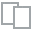
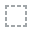
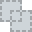
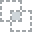
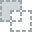
...
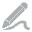
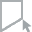
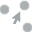
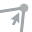
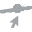

In [26]:
reload(co)
reload(cr)
from dataprep.eda import plot as dp_plot
# create section containing markdown
cs = co.CustomSection(
    title="My Section",
    customobjects=co.CustomDataPrep("My dataprep object", dp_plot(df))
)
# add section to context
context = cr.add_section(cr.create_empty_context(), cs)

# create report
report = cr.create_custom_report(context=context)
report.show()

# Random functions

In [8]:
def clear_dict(d: dict, value = None, copy: bool = False):
    """Replaces all values in a dictionary that are not dictionaries themselves
    with `value`. Recursses through nested dictionaries.
    """
    if copy:
        from copy import deepcopy
        d = deepcopy(d)

    _keys = list(d.keys())
    for _key in _keys:
        if not isinstance(d[_key], dict):
            d[_key] = value
        else:
            d[_key] = clear_dict(
                d=d[_key],
                value=value,
                copy=copy
            )
    return d


In [9]:
def apply_dict(d: dict, func = None, copy: bool = False, error_value = "error"):
    """Applies `func` to all values in a dictionary that are not dictionaries
    themselves. Recursses through nested dictionaries.
    """
    if copy:
        from copy import deepcopy
        d = deepcopy(d)

    _keys = list(d.keys())
    for _key in _keys:
        if not isinstance(d[_key], dict):
            try:
                d[_key] = func(d[_key])
            except:
                d[_key] = error_value
        else:
            d[_key] = apply_dict(
                d=d[_key],
                func=func,
                copy=copy,
                error_value=error_value
            )
    return d


In [17]:
# this created an empty frame
cleared_context = clear_dict(context, copy = True)
# cleared_context
# this is the empty report with no content at all but all the "junk" keys from a previously created context
# it is better to use create_empty_context() than to clear and existing one
cr.create_custom_report(context=cleared_context).show_browser()

In [10]:
stringed_context = apply_dict(context, str, copy = True)
print(json.dumps(
    {k: v for k, v in stringed_context.items() if k != "resources"},
    indent = 4))
#stringed_context.keys()

{
    "title": "DataPrep Report",
    "components": {
        "overview_insights": {
            "1": "[{'Uniform': '/*start*/PassengerId/*end*/ is uniformly distributed'}, {'Missing': '/*start*/Age/*end*/ has 177 (19.87%) missing values'}, {'Missing': '/*start*/Cabin/*end*/ has 687 (77.1%) missing values'}, {'Skewed': '/*start*/Fare/*end*/ is skewed'}, {'High Cardinality': '/*start*/Name/*end*/ has a high cardinality: 891 distinct values'}, {'High Cardinality': '/*start*/Ticket/*end*/ has a high cardinality: 681 distinct values'}, {'High Cardinality': '/*start*/Cabin/*end*/ has a high cardinality: 147 distinct values'}, {'Constant Length': '/*start*/Survived/*end*/ has constant length 1'}, {'Constant Length': '/*start*/Pclass/*end*/ has constant length 1'}, {'Constant Length': '/*start*/SibSp/*end*/ has constant length 1'}]",
            "2": "[{'Constant Length': '/*start*/Parch/*end*/ has constant length 1'}, {'Constant Length': '/*start*/Embarked/*end*/ has constant length 1'}, {'U

# Other Stuff 

In [4]:
from dataprep.eda import plot
from dataprep.datasets import load_dataset
import numpy as np


In [16]:
import plotly.express as px
from numpy.random import default_rng
rng = default_rng()

x = px.scatter(x = rng.random(50), y = rng.random(50))
plotly_soup = BeautifulSoup(x.to_html(), "html.parser")


<head><meta charset="utf-8"/></head>

In [17]:
plotly_soup.find("head")

<head><meta charset="utf-8"/></head>

In [18]:
df = load_dataset('adult')
x = plot(df)
print(type(x))
# with open("dump.html", "w") as fp:
#     fp.write(x._repr_html_())
# print(x._repr_html_()[:200])

  0%|          | 0/621 [00:00<?, ?it/s]

<class 'dataprep.eda.container.Container'>


# TODO
Use beautiful soup to separate the html string into:
- head (these items need to be included in the rendered version of body)
    - title element (probably will be ignored)
    - array of script elements
    - array of style elements
- body (all the elements of body)

**Note: There is no header or footer elements in the container**


In [7]:
from bs4 import BeautifulSoup
soup = BeautifulSoup(x._repr_html_(), "html.parser")

In [8]:
print(len(soup.find_all("script")))
print(len(soup.find_all("style")))
print(len(soup.find_all("body")))

# TODO: Make a CustomDataPrep class which takes a dataprep.eda.container.Container
# and returns the raw HTML, the list of scripts, the list of styles and the body

# when bringing all elements into one report, check if the style element to be added
# is not exactly the same as one currently in the list of styles (HOW?) before adding it

6
1
1


In [13]:
scripts = soup.find_all("script")
print(type(scripts[0]))
scripts[0].attrs

<class 'bs4.element.Tag'>


{'type': 'text/javascript'}

In [10]:
soup.find_all("style")

[<style>
     .plot-1391 {
         font-family: -apple-system, 'Helvetica Neue', 'Helvetica', 'Arial', 'Lucida Grande', sans-serif;
         -webkit-font-smoothing: antialiased;
         display: flex;
         flex-wrap: wrap;
         max-width: 972px;
     }
 
     .fig-1391 {
         flex: 1 1 30%;
         margin-top: 10px;
         background: white;
     }
 
     .menu-1391 {
         width: 293px;
         height: 20px;
         position: relative;
         left: 27px;
     }
 
     .insight-pre-1391 {
         max-width: 200px;
         font-size: 10px;
         display: flex;
         justify-content: space-between;
         align-content: center;
         cursor: none;
     }
 
     .insight-pre-1391>span{
         margin: 0 5px;
     }
 
     .col-cat-des-1391 {
         flex: 0 1 auto;
         text-overflow: clip;
         overflow: hidden;
         white-space: nowrap;
     }
 
     .plot-title-1391 {
         display: inline-block;
         width: 245px;
         vert

In [114]:
type(soup.find("script"))

bs4.element.Tag

In [87]:
# this container contains a table
from dataprep.eda import plot_correlation
from dataprep.datasets import load_dataset
df = load_dataset("wine-quality-red")
x = plot_correlation(df)
print(type(x))
x.context

<class 'dataprep.eda.container.Container'>


In [ ]:
ENV_LOADER = Environment(
    loader=PackageLoader("dataprep", "eda/create_report/templates"),
)
template_base = ENV_LOADER.get_template("base_extended.html")
template_base

In [70]:
reload(cu)
x = cu.CustomTable(
    name="mytable",
    obj=pd.DataFrame({"a" :list("123456"), "b" :list("abcdef")})
)

In [71]:
vars(x)

{'name': 'mytable',
 'object_type': 'table',
 'html': '<table border="1" class="dataframe">\n  <thead>\n    <tr style="text-align: right;">\n      <th></th>\n      <th>a</th>\n      <th>b</th>\n    </tr>\n  </thead>\n  <tbody>\n    <tr>\n      <th>0</th>\n      <td>1</td>\n      <td>a</td>\n    </tr>\n    <tr>\n      <th>1</th>\n      <td>2</td>\n      <td>b</td>\n    </tr>\n    <tr>\n      <th>2</th>\n      <td>3</td>\n      <td>c</td>\n    </tr>\n    <tr>\n      <th>3</th>\n      <td>4</td>\n      <td>d</td>\n    </tr>\n    <tr>\n      <th>4</th>\n      <td>5</td>\n      <td>e</td>\n    </tr>\n    <tr>\n      <th>5</th>\n      <td>6</td>\n      <td>f</td>\n    </tr>\n  </tbody>\n</table>'}

In [72]:
x = cu.CustomTable(
    name="mytable",
    obj=list("ab")
)

TypeError: `obj` must be a pandas.DataFrame of a nump.ndarray. Got <class 'list'>

In [34]:
report.show_browser()

In [ ]:
print(template_base.filename)
template_paths = glob.glob(template_base.filename.replace("base.html","*.html"))
context_variables = []
for template_path in template_paths: 
    with open(template_path, "r") as fp:
        template_str = fp.readlines()
    ts = [re.search("context\.[\S]+", line) for line in template_str]
    ts = [match for match in ts if match is not None]
    ts = [match.group() for match in ts]
    context_variables += ts




In [ ]:
# list of context variables that are used in the html templates
sorted(set(context_variables))

In [ ]:
import PIL
import base64

def get_image_url(path: str):
    """ Generates a base64 url from an image
        path
            path to file that can be loaded by open(). Currently accepts .png and .svg files.
    """
    mime_types = {
        "png": "image/png", 
        "svg": "image/svg+xml", #not yet tested
        "apng": "image/apng", #not yet tested
        "avif": "image/avif", #not yet tested
        "gif": "image/gif", #not yet tested
        "jpg": "image/jpeg", #not yet tested
        "jpeg": "image/jpeg", #not yet tested
        "webp": "image/webp", #not yet tested
    }

    file_type = path.split(".")[-1]
    print(file_type)
    with open(path, mode = "rb") as im:
        image_str = base64.b64encode(im.read()).decode()

    image_url = f"data:{mime_types[file_type]}:base64,{image_str}"
    return image_url


# with open("images/crayon logo.png", mode = "rb") as im:
#     image_str = base64.b64encode(im.read()).decode()
#     image_str
# mime_type = "image/png"
# image_url = f"data:{mime_type}:base64,{image_str}"
# image_url

# get_image_url("images/crayon logo.png")


In [ ]:
im.read()

In [ ]:
print(logo)

### images

In [ ]:
# use matplotlib rather than PIL because it is probably already a requirment
from matplotlib.image import imread
import matplotlib.pyplot as plt
import PIL
import numpy as np
# mpl = matplotlip
from_mpl_header = imread("images/crayon header.jpeg")
print(from_mpl_header.shape)
from_mpl_logo = imread("images/crayon logo.png")
print(from_mpl_logo.shape)

with PIL.Image.open("images/crayon header.jpeg", mode = "r") as im:
    print(type(im))
    print(np.asarray(im).shape)

with PIL.Image.open("images/crayon logo.png", mode = "r") as im:
    print(type(im))
    print(np.asarray(im).shape)

fig = plt.figure()
plt.imshow(im)
plt.axis("off")

# imshow also works with PIL images!


returning the contect dictionary too

In [ ]:
# return the context dictionary too
import warnings
from typing import Any, Dict, List, Optional, Union

import pandas as pd
from bokeh.resources import INLINE
from jinja2 import Environment, PackageLoader

#from ..configs import Config
#from .formatter import format_report
#from .report import Report
from dataprep.eda.configs import Config
from dataprep.eda.create_report.formatter import format_report
from dataprep.eda.create_report.report import Report

# my additions
from dataprep.eda.create_report import _suppress_warnings

def create_report2(
    df: Optional[pd.DataFrame] = None,
    *,
    config: Optional[Dict[str, Any]] = None,
    display: Optional[List[str]] = None,
    title: Optional[str] = "DataPrep Report",
    mode: Optional[str] = "basic",
    progress: bool = True,
    context: Optional[Dict[str,Any]] = None,
    returnreport: bool = True,
    returncontext: bool = False,
    #customsections: Optional[Union[CustomSection, List[CustomSection]]] = None,
) -> Report:
    """
    This function is to generate and render element in a report object.

    Parameters
    ----------
    df
        The DataFrame for which data are calculated. Must be provided if `context` is None.
    config
        A dictionary for configuring the visualizations
        E.g. config={"hist.bins": 20}
    display
        The list that contains the names of plots user wants to display,
        E.g. display =  ["bar", "hist"]
        Without user's specifications, the default is "auto"
    title: Optional[str], default "DataPrep Report"
        The title of the report, which will be shown on the navigation bar.
    mode: Optional[str], default "basic"
        This controls what type of report to be generated.
        Currently only the 'basic' is fully implemented.
    progress
        Whether to show the progress bar.
    context
        context dictionary of the format generated by this function
    returnreport:
        Whether to return the Report object created by this function
    returncontext
        Whether to return the context dictionary used to create the report
    customsections
        Custom sections to add to the end of the report

    Examples
    --------
    >>> import pandas as pd
    >>> from dataprep.eda import create_report
    >>> df = pd.read_csv('https://raw.githubusercontent.com/mwaskom/seaborn-data/master/iris.csv')
    >>> report = create_report(df)
    >>> report # show report in notebook
    >>> report.save('My Fantastic Report') # save report to local disk
    >>> report.show_browser() # show report in the browser
    """
    _suppress_warnings()
    if not context:
        cfg = Config.from_dict(display, config)
        context = {
            "resources": INLINE.render(),
            "title": title,
            "components": format_report(df, cfg, mode, progress),
        }

    # if customsections:
    #     context["components"]["has_customsections"] = True
    #     if isinstance(customsections, CustomSection):
    #         customsections = [customsections]
    #     for section in customsections:
    #         context = add_section(context, section)

    if (not returnreport) and returncontext:
        return context

    template_base = ENV_LOADER.get_template("base.html")
    report = template_base.render(context=context)

    if returnreport and returncontext:
        return Report(report), context
    elif returnreport and (not returncontext):
        return Report(report)
    else:
        return None

In [ ]:
report, context = create_report2(df, returncontext=True)

In [ ]:
context["components"]["missing"][1]

In [ ]:
report.show_browser()

In [ ]:
print(json.dumps(context["components"]["variables"]["PassengerId"]["tabledata"], indent = 2))

In [ ]:
p = context["components"]["variables"]["PassengerId"]["plots"]
print(type(p[0]))
print(type(p[1]))
print(p[1])
print(os.getcwd())
# with open(os.getcwd()+"/dump.txt", "w") as fp:
#     fp.writelines(p[0])

In [ ]:
context["components"]["overview_insights"]
context["components"]["overview"]
keys = list(context["components"]["variables"].keys())
print(keys)
for item in context["components"]["variables"]["PassengerId"].items():
    if item[0] != "plots":
        print(item)
        print()

In [ ]:
# for k in keys:
#     print(k)
#     print(list(context["components"]["variables"][k]["plots_tab"]))


In [ ]:
cfg = Config.from_dict()